In [1]:
import pandas as pd
pd.set_option('display.max_columns', None) # Show all columns
pd.set_option('display.max_rows', None)      # Limit number of rows shown
pd.set_option('display.width', 1000)       # Width of the display in characters

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
import scipy.stats as stats
import seaborn as sns
from sklearn import linear_model
import statsmodels.api as sm 
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import cross_val_score, GridSearchCV

In [3]:
price = pd.read_csv('Ames_HousePrice.csv')
price.drop(columns=['Unnamed: 0'], inplace=True)
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,484.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Normal
9,9081860

In [4]:
columns_to_sum = [
    'PoolArea', 'EnclosedPorch', 'ScreenPorch', 'OpenPorchSF', 'WoodDeckSF',
    '3SsnPorch', 'GarageArea', 'GrLivArea', 'TotalBsmtSF', 'MasVnrArea'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalArea'] = price[columns_to_sum].fillna(0).sum(axis=1)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea
0,909176150,856,126000,30,RL,NaN,7890,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,NaN,0.0,TA,TA,CBlock,TA,TA,No,Rec,238.0,Unf,0.0,618.0,856.0,GasA,TA,Y,SBrkr,856,0,0,1.0,0.0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2.0,399.0,TA,TA,Y,0,0,0,0,166,0,NaN,NaN,NaN,0,3,2010,WD,Normal,2277.0
1,905476230,1049,139500,120,RL,42.0,4235,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149.0,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552.0,ALQ,393.0,104.0,1049.0,GasA,TA,Y,SBrkr,1049,0,0,1.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1984.0,Fin,1.0,266.0,TA,TA,Y,0,105,0,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2618.0
2,911128020,1001,124900,30,C (all),60.0,6060,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,TA,BrkTil,TA,TA,No,ALQ,737.0,Unf,0.0,100.0,837.0,GasA,Ex,Y,SBrkr,1001,0,0,0.0,0.0,1,0,2,1,Gd,5,Typ,0,NaN,Detchd,1930.0,Unf,1.0,216.0,TA,Po,N,154,0,42,86,0,0,NaN,NaN,NaN,0,11,2007,WD,Normal,2336.0
3,535377150,1039,114000,70,RL,80.0,8146,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0.0,Unf,0.0,405.0,405.0,GasA,Gd,Y,SBrkr,717,322,0,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1940.0,Unf,1.0,281.0,TA,TA,N,0,0,168,0,111,0,NaN,NaN,NaN,0,5,2009,WD,Normal,2004.0
4,534177230,1665,227000,60,RL,70.0,8400,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,643.0,Unf,0.0,167.0,810.0,GasA,Ex,Y,SBrkr,810,855,0,1.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,2001.0,Fin,2.0,528.0,TA,TA,Y,0,45,0,0,0,0,NaN,NaN,NaN,0,11,2009,WD,Normal,3048.0
5,908128060,1922,198500,85,RL,64.0,7301,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,NaN,NaN,NaN,0,7,2009,ConLD,Normal,3271.0
6,902135020,936,93000,20,RM,60.0,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,Fa,TA,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,TA,N,SBrkr,936,0,0,0.0,0.0,1,0,2,1,TA,4,Min2,0,NaN,Detchd,1974.0,Unf,2.0,576.0,TA,TA,Y,0,32,112,0,0,0,NaN,NaN,NaN,0,2,2009,WD,Normal,2592.0
7,528228540,1246,187687,20,RL,53.0,3710,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20.0,Gd,TA,PConc,Gd,TA,Gd,Unf,0.0,Unf,0.0,1146.0,1146.0,GasA,Ex,Y,SBrkr,1246,0,0,0.0,0.0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2.0,428.0,TA,TA,Y,100,24,0,0,0,0,NaN,NaN,NaN,0,3,2008,New,Partial,2964.0
8,923426010,889,137500,20,RL,74.0,12395,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,1Story,5,6,1984,1984,Gable,CompShg,HdBoard,Plywood,NaN,0.0,TA,TA,CBlock,TA,TA,No,ALQ,647.0,Unf,0.0,217.0,864.0,GasA,TA,Y,SBrkr,889,0,0,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1984.0,Unf,2.0,

In [5]:
price['Alley'] = price['Alley'].fillna('No Alley Access')
price['MasVnrType'] = price['MasVnrType'].fillna('None')
price['BsmtQual'] = price['BsmtQual'].fillna('No Basement')
price['BsmtCond'] = price['BsmtCond'].fillna('No Basement')
price['BsmtExposure'] = price['BsmtExposure'].fillna('No Basement')
price['BsmtFinType1'] = price['BsmtFinType1'].fillna('No Basement')
price['BsmtFinType2'] = price['BsmtFinType2'].fillna('No Basement')
price['FireplaceQu'] = price['FireplaceQu'].fillna('No Fireplace')
price['GarageType'] = price['GarageType'].fillna('No Garage')
price['GarageYrBlt'] = price['GarageYrBlt'].fillna('No Garage')
price['GarageFinish'] = price['GarageFinish'].fillna('No Garage')
price['GarageQual'] = price['GarageQual'].fillna('No Garage')
price['GarageCond'] = price['GarageCond'].fillna('No Garage')
price['PoolQC'] = price['PoolQC'].fillna('No Pool')
price['Fence'] = price['Fence'].fillna('No Fence')
price['MiscFeature'] = price['MiscFeature'].fillna('None')

In [6]:
price.loc[price['MasVnrType'] == 'None', 'MasVnrArea'] = 0
price.loc[price['BsmtFinType1'] == 'No Basement', 'BsmtFinSF1'] = 0
price.loc[price['BsmtFinType2'] == 'No Basement', 'BsmtFinSF2'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtUnfSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'TotalBsmtSF'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtFullBath'] = 0
price.loc[price['BsmtCond'] == 'No Basement', 'BsmtHalfBath'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageCars'] = 0
price.loc[price['GarageFinish'] == 'No Garage', 'GarageArea'] = 0

In [7]:
price['MasVnrArea'] = price['MasVnrArea'].fillna(0).astype('int64')
price['BsmtFinSF1'] = price['BsmtFinSF1'].fillna(0).astype('int64')
price['BsmtFinSF2'] = price['BsmtFinSF2'].fillna(0).astype('int64')
price['BsmtUnfSF'] = price['BsmtUnfSF'].fillna(0).astype('int64')
price['TotalBsmtSF'] = price['TotalBsmtSF'].fillna(0).astype('int64')
price['BsmtFullBath'] = price['BsmtFullBath'].fillna(0).astype('int64')
price['GarageCars'] = price['GarageCars'].fillna(0).astype('int64')
price['BsmtHalfBath'] = price['BsmtHalfBath'].fillna(0).astype('int64')
price['GarageArea'] = price['GarageArea'].fillna(0).astype('int64')

In [8]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].mean())

In [9]:
# 2. Create the model
ols = linear_model.LinearRegression()

# Select only numerical columns
numerical_cols = price.select_dtypes(include=[np.number]).columns

# Target variable
y = price['SalePrice']

# Empty dictionary to store R² values
r2_scores = {}

for col in numerical_cols:
    if col != 'SalePrice':  # skip the target itself
        if price[col].isnull().sum() == 0:  # check if no missing values
            X = price[[col]]  # must be 2D
            ols.fit(X, y)
            r2 = ols.score(X, y)  # get R²
            r2_scores[col] = r2
        else:
            pass  # skip columns with NaN

# 6. Sort results by R² descending
sorted_r2 = dict(sorted(r2_scores.items(), key=lambda item: item[1], reverse=True))

# 7. Display nicely
for feature, r2 in sorted_r2.items():
    print(f"{feature}: R² = {r2:.4f}")

TotalArea: R² = 0.7311
OverallQual: R² = 0.6249
GrLivArea: R² = 0.5184
TotalBsmtSF: R² = 0.4257
1stFlrSF: R² = 0.4130
GarageCars: R² = 0.4070
GarageArea: R² = 0.4023
YearBuilt: R² = 0.2963
FullBath: R² = 0.2862
YearRemodAdd: R² = 0.2645
MasVnrArea: R² = 0.2478
TotRmsAbvGrd: R² = 0.2403
Fireplaces: R² = 0.2383
BsmtFinSF1: R² = 0.2126
LotFrontage: R² = 0.1145
WoodDeckSF: R² = 0.1110
OpenPorchSF: R² = 0.0940
BsmtFullBath: R² = 0.0845
HalfBath: R² = 0.0817
LotArea: R² = 0.0753
2ndFlrSF: R² = 0.0692
PID: R² = 0.0512
BsmtUnfSF: R² = 0.0282
BedroomAbvGr: R² = 0.0230
EnclosedPorch: R² = 0.0152
ScreenPorch: R² = 0.0148
KitchenAbvGr: R² = 0.0130
OverallCond: R² = 0.0102
MSSubClass: R² = 0.0072
BsmtHalfBath: R² = 0.0011
3SsnPorch: R² = 0.0010
PoolArea: R² = 0.0010
LowQualFinSF: R² = 0.0010
BsmtFinSF2: R² = 0.0004
MiscVal: R² = 0.0004
MoSold: R² = 0.0002
YrSold: R² = 0.0000


In [10]:
columns_to_sum1 = [
    'BsmtFullBath', 'FullBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalFullBath'] = price[columns_to_sum1].fillna(0).sum(axis=1)

columns_to_sum2 = [
    'BsmtHalfBath', 'HalfBath'
]

# Make sure all NaNs are treated as 0 before summing
price['TotalHalfBath'] = price[columns_to_sum2].fillna(0).sum(axis=1)

R²: 0.8190
RSS: 2,627,422,113,112.99


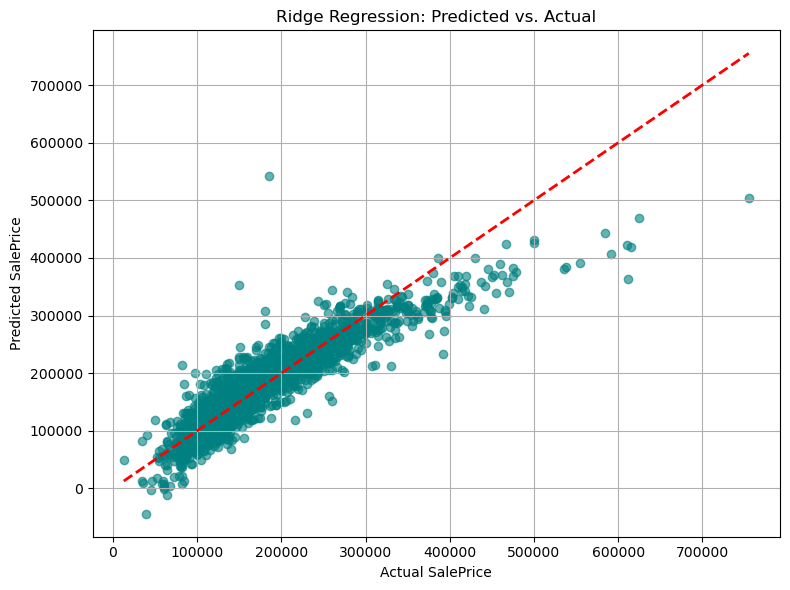

In [11]:
# Select variables
features = ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual']
target = 'SalePrice'

multi_feats = price[features + [target]].fillna(0)

# Define X and y
X = multi_feats[features]
y = multi_feats[target]

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual'])
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

ridge_pipeline = Pipeline([
    ('prep', preprocessor),  # Add preprocessing step
    ('reg', Ridge(alpha=1.0))
])

# Fit and evaluate on full data
ridge_pipeline.fit(X, y)
y_pred_ridge = ridge_pipeline.predict(X)
r2_ridge = r2_score(y, y_pred_ridge)
rss_ridge = np.sum((y - y_pred_ridge) ** 2)

print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")

# Predict using the fitted model
y_pred_ridge = ridge_pipeline.predict(X)

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y, y_pred_ridge, alpha=0.6, color='teal')
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Ridge Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

R² (Lasso on full data): 0.8190
RSS: 2,627,420,725,421.58


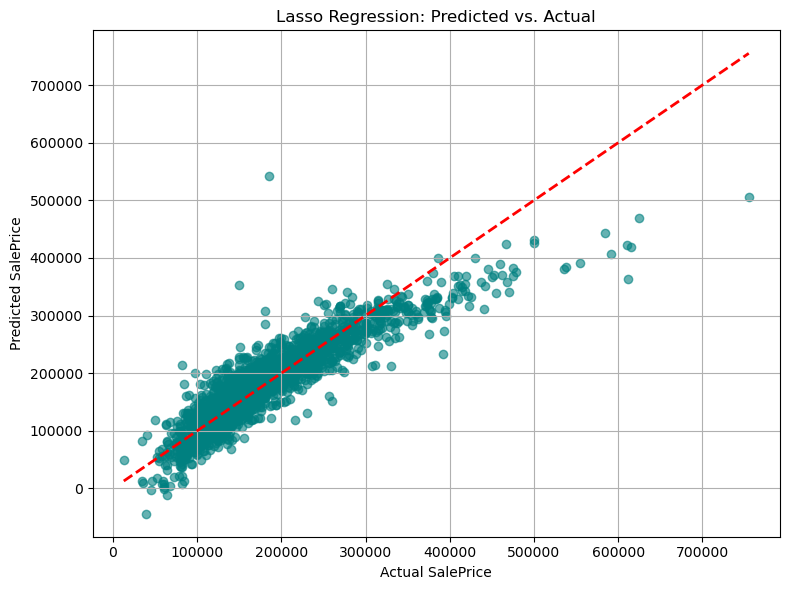

In [12]:
# Select variables
features = ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual']
target = 'SalePrice'

multi_feats = price[features + [target]].fillna(0)

# Define X and y
X = multi_feats[features]
y = multi_feats[target]

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'TotalFullBath', 'TotalHalfBath', 'TotRmsAbvGrd', 'OverallQual'])
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

lasso_pipeline = Pipeline([
    ('prep', preprocessor),  # Add this step
    ('reg', Lasso(alpha=0.1, max_iter=10000))
])

# Fit and evaluate on full data
lasso_pipeline.fit(X, y)
y_pred_lasso = lasso_pipeline.predict(X)
r2_lasso = r2_score(y, y_pred_lasso)
rss_lasso = np.sum((y - y_pred_lasso) ** 2)

print(f"R² (Lasso on full data): {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")

# Predict using the fitted model
y_pred_lasso = lasso_pipeline.predict(X)

# Create scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(y, y_pred_lasso, alpha=0.6, color='teal')
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2)  # 45-degree line
plt.xlabel('Actual SalePrice')
plt.ylabel('Predicted SalePrice')
plt.title('Lasso Regression: Predicted vs. Actual')
plt.grid(True)
plt.tight_layout()
plt.show()

In [13]:
# Define features and target
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea']),
        ('cat', categorical_transformer, ['Neighborhood'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Ridge pipeline
ridge_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Ridge(alpha=1.0))
])

# Fit and evaluate on full data
ridge_pipeline.fit(X, y)
y_pred_ridge = ridge_pipeline.predict(X)
r2_ridge = r2_score(y, y_pred_ridge)
rss_ridge = np.sum((y - y_pred_ridge) ** 2)

print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")

R²: 0.8167
RSS: 2,660,625,289,563.09


In [14]:
# Define features and target
features = ['TotalArea', 'Neighborhood']
target = 'SalePrice'

# Fill missing values with 0
hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = hood[features]
y = hood[target]

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea']),
        ('cat', categorical_transformer, ['Neighborhood'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Lasso pipeline
lasso_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Lasso(alpha=.1, max_iter=10000))
])

# Fit and evaluate on full data
lasso_pipeline.fit(X, y)
y_pred_lasso = lasso_pipeline.predict(X)
r2_lasso = r2_score(y, y_pred_lasso)
rss_lasso = np.sum((y - y_pred_lasso) ** 2)

print(f"R²: {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")


R²: 0.8170
RSS: 2,656,501,259,905.48


In [15]:
price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea,TotalFullBath,TotalHalfBath
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0,2,0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0,3,0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0,1,0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0,1,0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0,3,1
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0,3,0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0,1,0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3,2008,New,Partial,2964.0,2,0
8,923426010,889,137500,20,RL,74.000000,12395,Pave,No Alley Access,Reg,Lvl,A

In [16]:
price.isnull().sum()

PID              0
GrLivArea        0
SalePrice        0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
Alley            0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr

In [17]:
# Select only numerical columns
numerical_cols = price.select_dtypes(include=[np.number]).columns

# Target variable
y = price['SalePrice']

# Empty dictionary to store R² values
r2_scores = {}

for col in numerical_cols:
    if col != 'SalePrice':  # skip the target itself
        if price[col].isnull().sum() == 0:  # check if no missing values
            X = price[[col]]  # must be 2D
            ols.fit(X, y)
            r2 = ols.score(X, y)  # get R²
            r2_scores[col] = r2
        else:
            pass  # skip columns with NaN

# 6. Sort results by R² descending
sorted_r2 = dict(sorted(r2_scores.items(), key=lambda item: item[1], reverse=True))

# 7. Display nicely
for feature, r2 in sorted_r2.items():
    print(f"{feature}: R² = {r2:.4f}")

TotalArea: R² = 0.7311
OverallQual: R² = 0.6249
GrLivArea: R² = 0.5184
TotalBsmtSF: R² = 0.4257
1stFlrSF: R² = 0.4130
GarageCars: R² = 0.4070
GarageArea: R² = 0.4023
TotalFullBath: R² = 0.3541
YearBuilt: R² = 0.2963
FullBath: R² = 0.2862
YearRemodAdd: R² = 0.2645
MasVnrArea: R² = 0.2478
TotRmsAbvGrd: R² = 0.2403
Fireplaces: R² = 0.2383
BsmtFinSF1: R² = 0.2126
LotFrontage: R² = 0.1145
WoodDeckSF: R² = 0.1110
OpenPorchSF: R² = 0.0940
BsmtFullBath: R² = 0.0845
HalfBath: R² = 0.0817
LotArea: R² = 0.0753
2ndFlrSF: R² = 0.0692
TotalHalfBath: R² = 0.0619
PID: R² = 0.0512
BsmtUnfSF: R² = 0.0282
BedroomAbvGr: R² = 0.0230
EnclosedPorch: R² = 0.0152
ScreenPorch: R² = 0.0148
KitchenAbvGr: R² = 0.0130
OverallCond: R² = 0.0102
MSSubClass: R² = 0.0072
BsmtHalfBath: R² = 0.0011
3SsnPorch: R² = 0.0010
PoolArea: R² = 0.0010
LowQualFinSF: R² = 0.0010
BsmtFinSF2: R² = 0.0004
MiscVal: R² = 0.0004
MoSold: R² = 0.0002
YrSold: R² = 0.0000


In [18]:
# Automatically detect categorical columns
categorical_cols = price.select_dtypes(include='object').columns.tolist()
target = 'SalePrice'

# Fill missing values
price[categorical_cols] = price[categorical_cols].fillna('Missing')
price[target] = price[target].fillna(0)

# Collect (feature, r²) pairs
r2_results = []

for col in categorical_cols:
    X = price[[col]].fillna('Missing').astype(str)
    y = price[target]

    preprocessor = ColumnTransformer(
        transformers=[
            ('cat', OneHotEncoder(drop='first'), [col])
        ]
    )

    pipeline = Pipeline([
        ('prep', preprocessor),
        ('reg', LinearRegression())
    ])

    pipeline.fit(X, y)
    y_pred = pipeline.predict(X)
    r2 = r2_score(y, y_pred)

    r2_results.append((col, r2))

# Sort results descending by R²
r2_results_sorted = sorted(r2_results, key=lambda x: x[1], reverse=True)

# Print
for col, r2 in r2_results_sorted:
    print(f"{col}: R² = {r2:.4f}")

Neighborhood: R² = 0.5598
ExterQual: R² = 0.4853
BsmtQual: R² = 0.4814
KitchenQual: R² = 0.4579
GarageYrBlt: R² = 0.3896
FireplaceQu: R² = 0.3010
GarageFinish: R² = 0.2906
Foundation: R² = 0.2671
GarageType: R² = 0.2344
BsmtFinType1: R² = 0.2291
HeatingQC: R² = 0.2024
BsmtExposure: R² = 0.1812
MasVnrType: R² = 0.1711
Exterior1st: R² = 0.1551
Exterior2nd: R² = 0.1538
MSZoning: R² = 0.1160
LotShape: R² = 0.0942
GarageQual: R² = 0.0869
SaleType: R² = 0.0813
GarageCond: R² = 0.0782
PavedDrive: R² = 0.0725
SaleCondition: R² = 0.0722
HouseStyle: R² = 0.0710
CentralAir: R² = 0.0664
RoofStyle: R² = 0.0587
Electrical: R² = 0.0566
BsmtCond: R² = 0.0499
Condition1: R² = 0.0453
Fence: R² = 0.0362
BldgType: R² = 0.0330
LandContour: R² = 0.0323
BsmtFinType2: R² = 0.0297
Condition2: R² = 0.0247
ExterCond: R² = 0.0220
LotConfig: R² = 0.0211
RoofMatl: R² = 0.0208
Alley: R² = 0.0202
Functional: R² = 0.0137
PoolQC: R² = 0.0118
Heating: R² = 0.0079
LandSlope: R² = 0.0063
MiscFeature: R² = 0.0042
Street: R

In [19]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]


# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'OverallQual', 'TotalFullBath', 'TotalHalfBath']),
        ('cat', categorical_transformer, ['Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 
                                          'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 'LotConfig', 
                                          'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 
                                          'CentralAir', 'KitchenQual', 'SaleType'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Ridge pipeline
ridge_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Ridge(alpha=1.0))
])

# Fit and evaluate on full data
ridge_pipeline.fit(X, y)
y_pred_ridge = ridge_pipeline.predict(X)
r2_ridge = r2_score(y, y_pred_ridge)
rss_ridge = np.sum((y - y_pred_ridge) ** 2)

print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")

R²: 0.8986
RSS: 1,471,721,343,378.65


In [20]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 'Foundation', 
            'OverallQual', 'TotalFullBath', 'TotalHalfBath', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 
            'LotConfig', 'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 'CentralAir',
            'KitchenQual', 'SaleType']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]


# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'OverallQual', 'TotalFullBath', 'TotalHalfBath']),
        ('cat', categorical_transformer, ['Neighborhood', 'MSSubClass', 'PoolQC', 'GarageQual', 'GarageType', 
                                          'Foundation', 'BsmtFinType1', 'BsmtFinType2', 'MSZoning', 'LotConfig', 
                                          'LandContour', 'Condition1', 'Exterior1st', 'MasVnrType', 'Heating', 
                                          'CentralAir', 'KitchenQual', 'SaleType'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Lasso pipeline
lasso_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Lasso(alpha=.1, max_iter=10000))
])

# Fit and evaluate on full data
lasso_pipeline.fit(X, y)
y_pred_lasso = lasso_pipeline.predict(X)
r2_lasso = r2_score(y, y_pred_lasso)
rss_lasso = np.sum((y - y_pred_lasso) ** 2)

print(f"R²: {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")

R²: 0.8995
RSS: 1,459,083,374,400.59


In [21]:
# Define what counts as a finished basement
finished_basement_types = ['GLQ', 'ALQ', 'BLQ', 'Rec', 'LwQ']

# Create new total room feature including finished basement types
price['TotalFinishedRooms'] = (
    price['TotRmsAbvGrd'] +
    price['BsmtFinType1'].apply(lambda x: 1 if x in finished_basement_types else 0) +
    price['BsmtFinType2'].apply(lambda x: 1 if x in finished_basement_types else 0)
)

price['TotalBathrooms'] = (
    price['FullBath'].fillna(0) +
    price['HalfBath'].fillna(0) * 0.5 +
    price['BsmtFullBath'].fillna(0) +
    price['BsmtHalfBath'].fillna(0) * 0.5
)

price

,PID,GrLivArea,SalePrice,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,TotalArea,TotalFullBath,TotalHalfBath,TotalFinishedRooms,TotalBathrooms
0,909176150,856,126000,30,RL,68.516053,7890,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,SWISU,Norm,Norm,1Fam,1Story,6,6,1939,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,CBlock,TA,TA,No,Rec,238,Unf,0,618,856,GasA,TA,Y,SBrkr,856,0,0,1,0,1,0,2,1,TA,4,Typ,1,Gd,Detchd,1939.0,Unf,2,399,TA,TA,Y,0,0,0,0,166,0,No Pool,No Fence,None,0,3,2010,WD,Normal,2277.0,2,0,5,2.0
1,905476230,1049,139500,120,RL,42.000000,4235,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,1Story,5,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,BrkFace,149,Gd,TA,CBlock,Gd,TA,Mn,GLQ,552,ALQ,393,104,1049,GasA,TA,Y,SBrkr,1049,0,0,1,0,2,0,2,1,Gd,5,Typ,0,No Fireplace,Attchd,1984.0,Fin,1,266,TA,TA,Y,0,105,0,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2618.0,3,0,7,3.0
2,911128020,1001,124900,30,C (all),60.000000,6060,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,5,9,1930,2007,Hip,CompShg,MetalSd,MetalSd,None,0,Gd,TA,BrkTil,TA,TA,No,ALQ,737,Unf,0,100,837,GasA,Ex,Y,SBrkr,1001,0,0,0,0,1,0,2,1,Gd,5,Typ,0,No Fireplace,Detchd,1930.0,Unf,1,216,TA,Po,N,154,0,42,86,0,0,No Pool,No Fence,None,0,11,2007,WD,Normal,2336.0,1,0,6,1.0
3,535377150,1039,114000,70,RL,80.000000,8146,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,2Story,4,8,1900,2003,Gable,CompShg,MetalSd,MetalSd,None,0,Gd,Gd,BrkTil,Fa,TA,No,Unf,0,Unf,0,405,405,GasA,Gd,Y,SBrkr,717,322,0,0,0,1,0,2,1,TA,6,Typ,0,No Fireplace,Detchd,1940.0,Unf,1,281,TA,TA,N,0,0,168,0,111,0,No Pool,No Fence,None,0,5,2009,WD,Normal,2004.0,1,0,6,1.0
4,534177230,1665,227000,60,RL,70.000000,8400,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,2Story,8,6,2001,2001,Gable,CompShg,VinylSd,VinylSd,None,0,Gd,TA,PConc,Gd,TA,No,GLQ,643,Unf,0,167,810,GasA,Ex,Y,SBrkr,810,855,0,1,0,2,1,3,1,Gd,6,Typ,0,No Fireplace,Attchd,2001.0,Fin,2,528,TA,TA,Y,0,45,0,0,0,0,No Pool,No Fence,None,0,11,2009,WD,Normal,3048.0,3,1,7,3.5
5,908128060,1922,198500,85,RL,64.000000,7301,Pave,No Alley Access,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500,Gd,TA,Slab,No Basement,No Basement,No Basement,No Basement,0,No Basement,0,0,0,GasA,Ex,Y,SBrkr,495,1427,0,0,0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2,672,TA,TA,Y,0,0,177,0,0,0,No Pool,No Fence,None,0,7,2009,ConLD,Normal,3271.0,3,0,7,3.0
6,902135020,936,93000,20,RM,60.000000,6000,Pave,Pave,Reg,Bnk,AllPub,Inside,Mod,OldTown,Norm,Norm,2fmCon,1Story,4,4,1953,1953,Gable,CompShg,MetalSd,MetalSd,None,0,Fa,TA,CBlock,Fa,TA,No,Unf,0,Unf,0,936,936,GasA,TA,N,SBrkr,936,0,0,0,0,1,0,2,1,TA,4,Min2,0,No Fireplace,Detchd,1974.0,Unf,2,576,TA,TA,Y,0,32,112,0,0,0,No Pool,No Fence,None,0,2,2009,WD,Normal,2592.0,1,0,4,1.0
7,528228540,1246,187687,20,RL,53.000000,3710,Pave,No Alley Access,Reg,Lvl,AllPub,Inside,Gtl,Blmngtn,Norm,Norm,1Fam,1Story,7,5,2007,2008,Gable,CompShg,WdShing,Wd Shng,BrkFace,20,Gd,TA,PConc,Gd,TA,Gd,Unf,0,Unf,0,1146,1146,GasA,Ex,Y,SBrkr,1246,0,0,0,0,2,0,2,1,Gd,5,Typ,1,Gd,Attchd,2007.0,Fin,2,428,TA,TA,Y,100,24,0,0,0,0,No Pool,No Fence,None,0,3,2008,New,Partial,2964.0,2,0

In [22]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]

# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'TotRmsAbvGrd', 'OverallQual', 'OverallCond',
                                      'TotalFullBath', 'TotalHalfBath']),
        ('cat', categorical_transformer, ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Ridge pipeline
ridge_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Ridge(alpha=1.0))
])

# Fit and evaluate on full data
ridge_pipeline.fit(X, y)
y_pred_ridge = ridge_pipeline.predict(X)
r2_ridge = r2_score(y, y_pred_ridge)
rss_ridge = np.sum((y - y_pred_ridge) ** 2)

print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")
print(cross_val_score(ridge_pipeline, X, y))
print(cross_val_score(ridge_pipeline, X, y).mean())

R²: 0.9001
RSS: 1,450,333,412,621.92
[0.85911548 0.898434   0.90805198 0.89123987 0.8960646 ]
0.8905811872271399


In [23]:
# Define features and target
features = ['TotalArea', 'Neighborhood', 'Foundation', 'GarageType', 'MSSubClass', 'FireplaceQu', 
            'TotRmsAbvGrd', 'OverallQual', 'OverallCond', 'TotalHalfBath', 'ExterQual', 'BsmtQual', 
            'BsmtExposure', 'TotalFullBath']
target = 'SalePrice' 

# Fill missing values with 0
# hood = price[features + [target]].fillna(0)

# Separate predictors and response
X = price[features]
y = price[target]


# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])


# Define preprocessing: one-hot encode 'Neighborhood'
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, ['TotalArea', 'TotRmsAbvGrd', 'OverallQual', 'OverallCond',
                                      'TotalFullBath', 'TotalHalfBath']),
        ('cat', categorical_transformer, ['Neighborhood', 'Foundation', 'GarageType', 'MSSubClass',
                                              'FireplaceQu', 'ExterQual', 'BsmtQual', 'BsmtExposure'])  # drop='first' avoids multicollinearity
    ],
    remainder='passthrough'  # keep other numeric features as they are
)

# Lasso pipeline
lasso_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Lasso(alpha=.1, max_iter=10000))
])

# Fit and evaluate on full data
lasso_pipeline.fit(X, y)
y_pred_lasso = lasso_pipeline.predict(X)
r2_lasso = r2_score(y, y_pred_lasso)
rss_lasso = np.sum((y - y_pred_lasso) ** 2)

print(f"R²: {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")
print(cross_val_score(lasso_pipeline, X, y))
print(cross_val_score(lasso_pipeline, X, y).mean())

R²: 0.9004
RSS: 1,445,512,132,324.07
[0.86087167 0.89849299 0.90769029 0.89088144 0.89462588]
0.8905124539092399


In [24]:
mode_val = price['Electrical'].mode(dropna=True)[0] 
price['Electrical'] = price['Electrical'].fillna(mode_val)

In [25]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].median())

In [26]:
X = price[numeric_features.tolist() + categorical_features.tolist()]
 
# Target variable
y = price['SalePrice']
 
# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for both numeric and categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Ridge pipeline
ridge_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Ridge())
])

# Grid search over alphas
alpha_range = list(range(1, 21))
ridge_grid = GridSearchCV(estimator=ridge_pipeline,
                          param_grid={'reg__alpha': alpha_range},
                          cv=5,
                          scoring='r2',
                          verbose=1)

ridge_grid.fit(X, y)

# Best results
best_ridge = ridge_grid.best_estimator_
best_alpha = ridge_grid.best_params_['reg__alpha']
best_cv_score = ridge_grid.best_score_

# Predict and evaluate on full data
y_pred = best_ridge.predict(X)
r2_ridge = r2_score(y, y_pred)
rss_ridge = np.sum((y - y_pred) ** 2)

# Cross-validation
cv_scores = cross_val_score(best_ridge, X, y, scoring='r2', cv=5, n_jobs=-1)

print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")
print(cv_scores)
print(cv_scores.mean())

Fitting 5 folds for each of 20 candidates, totalling 100 fits
R²: 0.9333
RSS: 967,870,641,559.24
[0.86582737 0.91917372 0.92835274 0.92378468 0.9251988 ]
0.91246746136657


In [28]:
X = price[numeric_features.tolist() + categorical_features.tolist()]
 
# Target variable
y = price['SalePrice']
 
# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for both numeric and categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Lasso pipeline
lasso_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Lasso(max_iter = 5000))
])

# Grid search over alphas
alpha_range = np.linspace(0.001, 1, 20)
lasso_grid = GridSearchCV(
    estimator=lasso_pipeline,
    param_grid={'reg__alpha': alpha_range},
    cv=5,
    scoring='r2',
    verbose=1
)

lasso_grid.fit(X, y)

# Best results
lasso_best_model = lasso_grid.best_estimator_
lasso_best_alpha = lasso_grid.best_params_['reg__alpha']
lasso_best_score = lasso_grid.best_score_

# Fit and evaluate on full data
y_pred_lasso = lasso_best_model.predict(X)
r2_lasso = r2_score(y, y_pred_lasso)
rss_lasso = np.sum((y - y_pred_lasso) ** 2)

# Cross-validation scores
cv_scores = cross_val_score(lasso_best_model, X, y, scoring='r2', cv=5, n_jobs=-1)

print(f"R²: {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")
print(cv_scores)
print(cv_scores.mean())

Fitting 5 folds for each of 20 candidates, totalling 100 fits


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 265092358771.56558, tolerance: 1090499258.1211665
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 149839103361.96002, tolerance: 1095980866.342594
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337697827564.4477, tolerance: 1189901463.3215556
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_desc

R²: 0.9410
RSS: 856,670,137,281.09
[0.8713594  0.9180901  0.90812129 0.9235396  0.91445024]
0.9071121252438905


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 84099971435.31268, tolerance: 1208763334.6803837
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 116897799835.3858, tolerance: 1220460612.956951
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4338872326.351685, tolerance: 1189901463.3215556
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descen

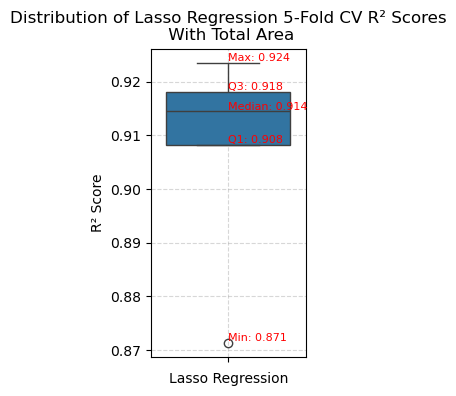

In [29]:
# Compute 5-number summary
minimum = np.min(cv_scores)
q1 = np.percentile(cv_scores, 25)
median = np.median(cv_scores)
q3 = np.percentile(cv_scores, 75)
maximum = np.max(cv_scores)

plt.figure(figsize=(2,4))
sns.boxplot(data=cv_scores)
plt.title('Distribution of Lasso Regression 5-Fold CV R² Scores\n With Total Area')
plt.ylabel('R² Score')
plt.xlabel('Lasso Regression')
plt.grid(True, linestyle='--', alpha=0.5)

# Annotate the 5-number summary on the plot
plt.text(0, minimum, f'Min: {minimum:.3f}', ha='left', va='bottom', fontsize=8, color='red')
plt.text(0, q1, f'Q1: {q1:.3f}', ha='left', va='bottom', fontsize=8, color='red')
plt.text(0, median, f'Median: {median:.3f}', ha='left', va='bottom', fontsize=8, color='red')
plt.text(0, q3, f'Q3: {q3:.3f}', ha='left', va='bottom', fontsize=8, color='red')
plt.text(0, maximum, f'Max: {maximum:.3f}', ha='left', va='bottom', fontsize=8, color='red')

plt.show()

In [30]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice', 'TotalArea']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Fill missing values for categorical and numeric columns
for col in categorical_features:
    mode_val = price[col].mode()[0]
    price[col] = price[col].fillna(mode_val).astype(str)  # ✅ Cast to string

for col in numeric_features:
    price[col] = price[col].fillna(price[col].median())

In [31]:
X = price[numeric_features.tolist() + categorical_features.tolist()]
 
# Target variable
y = price['SalePrice']
 
# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for both numeric and categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Ridge pipeline
ridge_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Ridge())
])

# Grid search over alphas
alpha_range = list(range(1, 21))
ridge_grid = GridSearchCV(estimator=ridge_pipeline,
                          param_grid={'reg__alpha': alpha_range},
                          cv=5,
                          scoring='r2',
                          verbose=1)

ridge_grid.fit(X, y)

# Best results
best_ridge = ridge_grid.best_estimator_
best_alpha = ridge_grid.best_params_['reg__alpha']
best_cv_score = ridge_grid.best_score_

# Predict and evaluate on full data
y_pred = best_ridge.predict(X)
r2_ridge = r2_score(y, y_pred)
rss_ridge = np.sum((y - y_pred) ** 2)

# Cross-validation
cv_scores = cross_val_score(best_ridge, X, y, scoring='r2', cv=5, n_jobs=-1)

print(f"R²: {r2_ridge:.4f}")
print(f"RSS: {rss_ridge:,.2f}")
print(cv_scores)
print(cv_scores.mean())

Fitting 5 folds for each of 20 candidates, totalling 100 fits
R²: 0.9334
RSS: 967,649,601,729.27
[0.86596413 0.91922374 0.92833033 0.92380009 0.92522281]
0.9125082183661517


In [33]:
X = price[numeric_features.tolist() + categorical_features.tolist()]
 
# Target variable
y = price['SalePrice']
 
# Pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])
 
# Pipeline for categorical features
categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])
 
# Combined preprocessor for both numeric and categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

# Lasso pipeline
lasso_pipeline = Pipeline([
    ('prep', preprocessor),
    ('reg', Lasso(max_iter = 5000))
])

# Grid search over alphas
alpha_range = np.linspace(0.001, 1, 20)
lasso_grid = GridSearchCV(
    estimator=lasso_pipeline,
    param_grid={'reg__alpha': alpha_range},
    cv=5,
    scoring='r2',
    verbose=1
)

lasso_grid.fit(X, y)

# Best results
lasso_best_model = lasso_grid.best_estimator_
lasso_best_alpha = lasso_grid.best_params_['reg__alpha']
lasso_best_score = lasso_grid.best_score_

# Fit and evaluate on full data
y_pred_lasso = lasso_best_model.predict(X)
r2_lasso = r2_score(y, y_pred_lasso)
rss_lasso = np.sum((y - y_pred_lasso) ** 2)

# Cross-validation scores
cv_scores = cross_val_score(lasso_best_model, X, y, scoring='r2', cv=5, n_jobs=-1)

print(f"R²: {r2_lasso:.4f}")
print(f"RSS: {rss_lasso:,.2f}")
print(cv_scores)
print(cv_scores.mean())
print(f"Alpha: {lasso_best_alpha}")

Fitting 5 folds for each of 20 candidates, totalling 100 fits


/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 111360591568.92114, tolerance: 1090499258.1211665
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 148322802406.9264, tolerance: 1095980866.342594
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:658: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 109927553805.86658, tolerance: 1189901463.3215556
  model = cd_fast.sparse_enet_coordinate_descent(
/opt/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_desc

R²: 0.9410
RSS: 856,817,746,133.46
[0.87134555 0.91809058 0.90810431 0.92357651 0.91441369]
0.9071061261307278
Alpha: 1.0


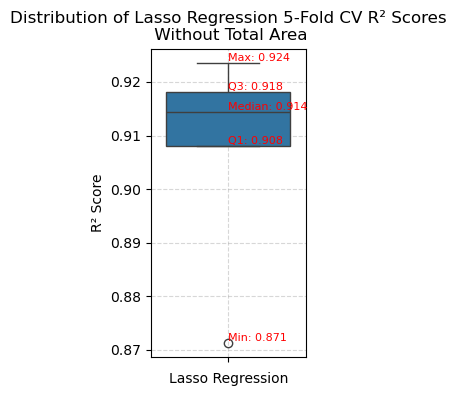

In [34]:
# Compute 5-number summary
minimum = np.min(cv_scores)
q1 = np.percentile(cv_scores, 25)
median = np.median(cv_scores)
q3 = np.percentile(cv_scores, 75)
maximum = np.max(cv_scores)

plt.figure(figsize=(2,4))
sns.boxplot(data=cv_scores)
plt.title('Distribution of Lasso Regression 5-Fold CV R² Scores\n Without Total Area')
plt.ylabel('R² Score')
plt.xlabel('Lasso Regression')
plt.grid(True, linestyle='--', alpha=0.5)

# Annotate the 5-number summary on the plot
plt.text(0, minimum, f'Min: {minimum:.3f}', ha='left', va='bottom', fontsize=8, color='red')
plt.text(0, q1, f'Q1: {q1:.3f}', ha='left', va='bottom', fontsize=8, color='red')
plt.text(0, median, f'Median: {median:.3f}', ha='left', va='bottom', fontsize=8, color='red')
plt.text(0, q3, f'Q3: {q3:.3f}', ha='left', va='bottom', fontsize=8, color='red')
plt.text(0, maximum, f'Max: {maximum:.3f}', ha='left', va='bottom', fontsize=8, color='red')

plt.show()

In [43]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Preprocess X to numeric-only form
X_processed = preprocessor.fit_transform(X)

# Get feature names after transformation:
feature_names_num = numeric_features.tolist()
feature_names_cat = preprocessor.named_transformers_['cat'].named_steps['onehot'].get_feature_names_out(categorical_features)
all_feature_names = feature_names_num + feature_names_cat.tolist()

# Sequential Feature Selector on processed (numeric-only) data:
model = Ridge()

sfs = SequentialFeatureSelector(model, n_features_to_select=5, direction='forward', cv=5)
sfs.fit(X_processed, y)

# Get selected features:
selected_mask = sfs.get_support()
selected_features = [feature for mask, feature in zip(selected_mask, all_feature_names) if mask]
print(f"Features selected by SFS: {selected_features}")

# Evaluate model using ONLY selected features:
X_selected = X_processed[:, selected_mask]
scores = cross_val_score(Ridge(), X_selected, y, cv=5, scoring='r2')
print(f"Mean CV R² Score using SFS with n=5: {scores.mean():.4f}")

Features selected by SFS: ['GrLivArea', 'MSSubClass', 'OverallQual', 'BsmtFinSF1', 'Foundation_Wood']
Mean CV R² Score using SFS with n=5: 0.8357


In [47]:
# Identify numeric and categorical features, excluding 'PID' and 'SalePrice'
numeric_features = price.select_dtypes(include=['int64', 'float64']).drop(columns=['PID', 'SalePrice']).columns
categorical_features = price.select_dtypes(include=['object']).columns

# Preprocess X to numeric-only form
X_processed = preprocessor.fit_transform(X)

# Get feature names after transformation:
feature_names_num = numeric_features.tolist()
feature_names_cat = preprocessor.named_transformers_['cat'].named_steps['onehot'].get_feature_names_out(categorical_features)
all_feature_names = feature_names_num + feature_names_cat.tolist()

# Sequential Feature Selector on processed (numeric-only) data:
model = Lasso()

sfs = SequentialFeatureSelector(model, n_features_to_select=5, direction='forward', cv=5)
sfs.fit(X_processed, y)

# Get selected features:
selected_mask = sfs.get_support()
selected_features = [feature for mask, feature in zip(selected_mask, all_feature_names) if mask]
print(f"Features selected by SFS: {selected_features}")

# Evaluate model using ONLY selected features:
X_selected = X_processed[:, selected_mask]
scores = cross_val_score(Lasso(), X_selected, y, cv=5, scoring='r2')
print(f"Mean CV R² Score using SFS with n=5: {scores.mean():.4f}")

Features selected by SFS: ['GrLivArea', 'MSSubClass', 'OverallQual', 'BsmtFinSF1', 'Foundation_Wood']
Mean CV R² Score using SFS with n=5: 0.8357
